In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier, export_graphviz, plot_tree
import graphviz
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, confusion_matrix
import pycaret

In [2]:
df = pd.read_csv('..\data\shortCleanData.csv')

In [3]:
from pycaret.clustering import *
import category_encoders as ce

In [4]:
######test comment

In [5]:
s = setup(df, ignore_features = ["Id","Zeitpunkt der Erstellung","SalesCount","Sales","Zeitpunkt der nderung","Zeitpunkt der Erstellung - Year","Zeitpunkt der nderung - Year"],max_encoding_ohe=1,normalize=False,normalize_method='maxabs',ordinal_features = {'1-Netto' : ['0 bis 600', '600 bis 1000', '1000 bis 1500','1500 bis 2000','2000 bis 2500','2500 bis 3000','3000 bis 3500','Mehr als 3500'],'1-Sprachzertifikat':['Nein','A1','A2','B1','B2','C1','C2']})

,Description,Value
0,Session id,7121
1,Original data shape,"(24639, 26)"
2,Transformed data shape,"(24639, 28)"
3,Ignore features,7
4,Ordinal features,2
5,Numeric features,1
6,Categorical features,18
7,Preprocess,True
8,Imputation type,simple
9,Numeric imputation,mean


In [6]:
test_Train = get_config("X_train_transformed")
test_Train

,1-Abschluss_0,1-Abschluss_1,1-Abschluss in DE_0,1-Deutscher Ehepartner_0,1-EB/NE erfllt?_0,1-Einreisejahr_0,1-Einreisejahr_1,1-Antrag EB_0,1-Antrag EB_1,1-Antrag NE_0,...,1-Rente_0,1-Rente_1,1-Sprachzertifikat,1-Test Sprache_Deutsch,1-Welches befristete AR haben Sie?_0,1-Welches befristete AR haben Sie?_1,1-Welches befristete AR haben Sie?_2,1-Wie ist ihr aktueller Familienstand?_0,1-Beratung?,1-Gltiger Nationalpass_0
0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,...,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0
1,0.0,2.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,...,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0
2,0.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,...,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0
3,0.0,2.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,...,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0
4,0.0,3.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,...,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24634,1.0,1.0,3.0,3.0,1.0,0.0,3.0,0.0,1.0,0.0,...,0.0,1.0,3.0,1.0,0.0,0.0,1.0,2.0,0.0,1.0
24635,1.0,1.0,3.0,2.0,3.0,0.0,4.0,0.0,1.0,1.0,...,0.0,1.0,1.0,1.0,0.0,0.0,2.0,2.0,0.0,1.0
24636,0.0,3.0,1.0,1.0,1.0,0.0,2.0,0.0,1.0,0.0,...,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0
24637,0.0,2.0,1.0,2.0,1.0,0.0,2.0,0.0,1.0,0.0,...,0.0,1.0,0.0,1.0,0.0,0.0,1.0,2.0,0.0,1.0


In [7]:
kmeans = create_model('kmeans')

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.1166,2734.9973,2.3473,0,0,0


In [8]:
plot_model(kmeans,plot='cluster')

In [9]:
plot_model(kmeans,plot='tsne')

In [10]:
ap = create_model('ap',num_clusters=4)

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.0888,103.8457,1.8899,0,0,0


In [11]:
evaluate_model(ap)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

In [12]:
meanshift = create_model('meanshift')

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.3312,46.4202,1.1956,0,0,0


In [13]:
evaluate_model(meanshift)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

In [14]:
plot_model(meanshift,plot='cluster')

In [18]:
spectral = create_model('sc',num_clusters=4)

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.0727,5.0854,0.9430,0,0,0


In [19]:
plot_model(spectral,plot='cluster')

In [25]:
hclust = create_model('hclust',num_clusters=8)

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.0683,1529.1207,2.3820,0,0,0


In [26]:
plot_model(hclust,plot='cluster')

In [27]:
plot_model(hclust,plot='tsne')

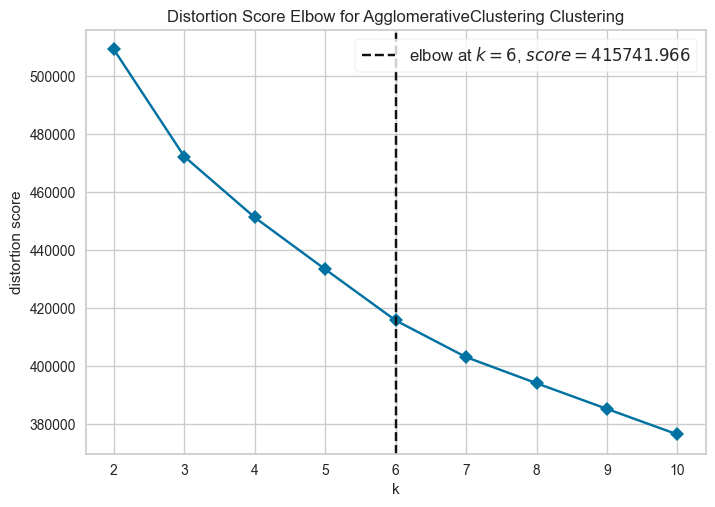

In [24]:
plot_model(hclust,plot='elbow')

In [30]:
plot_model(hclust,plot='distribution')

In [32]:
dbscan = create_model('dbscan')

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,-0.4069,5.6925,1.1038,0,0,0


In [33]:
plot_model(dbscan,plot='cluster')

In [34]:
optics = create_model('optics')

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,-0.4170,9.7926,1.3421,0,0,0


In [35]:
plot_model(optics,plot='cluster')

In [36]:
birch = create_model('birch')

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.0901,2042.2095,2.5248,0,0,0


In [37]:
plot_model(birch,plot='cluster')

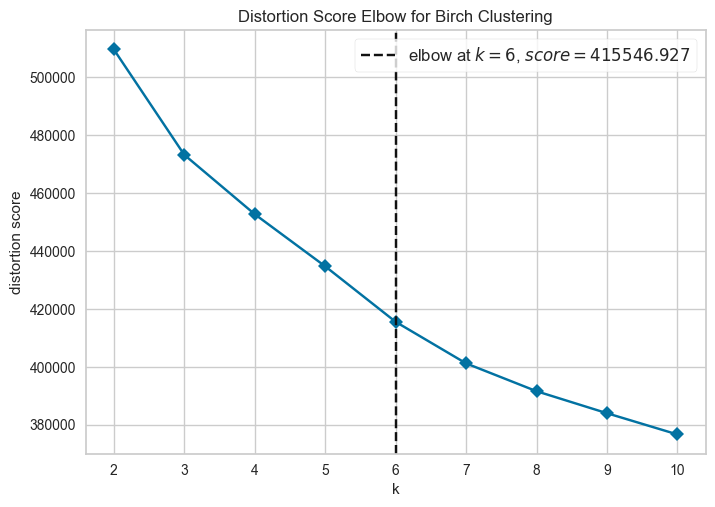

In [38]:
plot_model(birch,plot='elbow')

In [41]:
kmodes = create_model('kmodes')

ValueError: Estimator kmodes not available. Please see docstring for list of available estimators.